# Notebook for animations
run before generate_trans.ipynb for generate the interaction graph

In [36]:
import sys

sys.path.insert(0,'../sib/')
import csv
import sib
import os
import numpy as np
import pandas as pd
import sklearn.metrics as mm
# sir_inference imports
from sir_model import FastProximityModel, patient_zeros_states
from ranking import csr_to_list
import os.path
from os import path
N=10000
#N = 5000
#N = 100
## new try with 100 spreaders
N_patient_zero = 10;
#N_patient_zero = 1;
lamb_load = 0.05;
lamb = 0.05
mu = 0.02;
scale=1.0; # Easy Case
T=120;
seed=5;
location="networks"
# SIR parameters
t1 = 10;
#seed=int();

In [37]:
from pathlib import Path
import pandas as pd

fold_net = Path(location)
positions_file = "pos_proximity_N%dK_s%.1f_T%d_lamb%.2f_s%d.csv"%(N/1000,scale,T,lamb,seed)
pos_nodes = pd.read_csv(fold_net/positions_file)

In [38]:
## import sys
from time import time
import numpy as np
import pandas as pd
import os.path
from os import path
from scenario import Scenario
from sir_model import EpidemicModel, patient_zeros_states, symptomatic_individuals
from ranking import RANKINGS
log_fname="interactions_proximity_N%dK_s%.1f_T%d_lamb%.2f_s%d.csv"%(N/1000,scale,T,lamb_load,seed)
csv_file=location+"/"+log_fname
print("seed = %d"%seed, flush=True)
np.random.seed(seed);
if path.exists(csv_file): print("Loading model from %s"%csv_file)
else:
    raise ValueError("Could not find the file! Was looking for \n "+csv_file+"\n Bye-Bye")
    sys.exit()
print("Load Proximity model", flush=True)

tic = time()
model = EpidemicModel(initial_states=np.zeros(N), x_pos=np.zeros(N), y_pos=np.zeros(N))
model.load_transmissions(csv_file, new_lambda = lamb)
model.recover_probas = mu*np.ones(N)
print(f"Loading took {time()-tic:.1f}s",flush=True)
model.initial_states = patient_zeros_states(N, N_patient_zero)
model.time_evolution(model.recover_probas, model.transmissions, print_every=50)
t_max = len(model.transmissions)
print("Save plain dynamics", flush=True)
db = pd.DataFrame()
db["S"] = np.sum(model.states==0,axis=1)
db["I"] = np.sum(model.states==1,axis=1)
db["R"] = np.sum(model.states==2,axis=1)
db.to_csv("csv/Proximity_N%dK_T%d_s1_pz%d_mu%.2f_l%.2f_seed%d.csv"%(N/1000,T,N_patient_zero,mu,lamb,seed),
          index=False, sep="\t")

all_states = model.states
model.initial_states = model.states[t1]
model.states = model.states[t1:]
model.transmissions = model.transmissions[t1:]
model.pruned_transmissions = model.transmissions.copy()

seed = 5
Loading model from networks/interactions_proximity_N10K_s1.0_T120_lamb0.05_s5.csv
Load Proximity model
Loading transmissions from networks/interactions_proximity_N10K_s1.0_T120_lamb0.05_s5.csv
Loading took 11.7s
Running SIR simulation
t = 0 / 120
t = 50 / 120
t = 100 / 120
Save plain dynamics


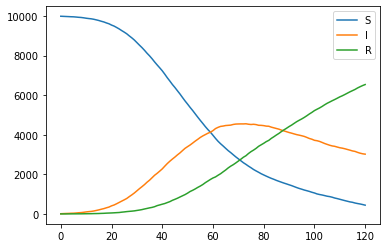

In [39]:
db.plot()

In [40]:
import pandas as pd
import matplotlib.pyplot as plt

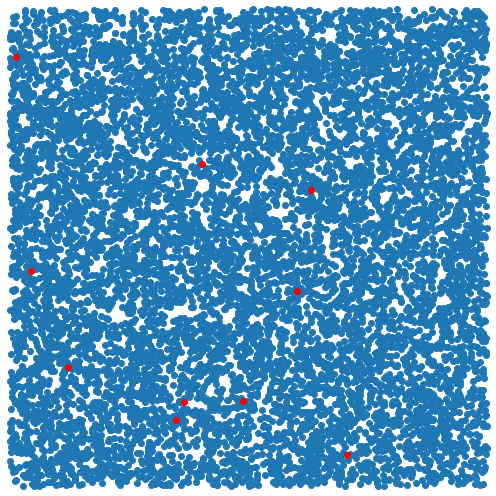

In [41]:
from matplotlib.animation import FuncAnimation, PillowWriter

fig,ax = plt.subplots(figsize=(7,7), frameon=False)
lim=0.6
ax.set(xlim=(pos_nodes.x.max()+lim, pos_nodes.x.min()-lim),
      ylim=(pos_nodes.y.max()+lim, pos_nodes.y.min()-lim))

#fig.patch.set_visible(False)
ax.axis('off')
ax.set_xticks([])
ax.set_yticks([])
plt.tight_layout()
time = 0


def get_nodes(t):
    return {i:np.where(all_states[t]==i)[0] for i in range(3)}
def setup_start(ax, pos_nodes, nodes_keys, colors, fn_get_nodes):

    nodes_idx = fn_get_nodes(0)
    paths = {}
    for nk, color in zip(nodes_keys, colors):
        g=pos_nodes.iloc[nodes_idx[nk]]
        paths[nk] = ax.scatter(g["x"],g["y"], color=color)
    return paths

paths = setup_start(ax, pos_nodes,  [0,1,2], colors=[None, "red","green"],
                   fn_get_nodes=get_nodes)
def animate(time):
    nodes_idx = get_nodes(time)
    for k in [0,1,2]:
        g=pos_nodes.iloc[nodes_idx[k]]
        paths[k].set_offsets(np.c_[g["x"].values, g["y"].values])

anim = FuncAnimation(
    fig, animate, interval=100, frames=T-1, cache_frame_data=False)

plt.draw()
plt.show()

#anim.save("sim.mov", codec="h263p", bitrate=-1)
#anim.save("sim.webm", codec="libvpx-vp9")
writer=PillowWriter(fps=15)
anim.save("sim.gif",writer=writer)


In [42]:
traces = {}
ranks_status ={}

In [43]:
def save_status(scenario, name):
    ranks_status[name]=scenario.status
    ranks_status[name]["t"]+=t1

In [48]:
tau = 5
# trac parameters
trac_tau = tau;
trac_lambd = lamb;
# MF parameters
MF_tau = tau;
MF_delta = 15;
# observation parameters
n_ranking = 60
p_untracked=0
#seed = int(sys.argv[2]);
#seeds for running [32,123,456]
#seed=int(sys.argv[1]);
################################################

intervention_options=dict(quarantine_time=T)
observation_options=dict(n_random=0,n_infected=0,n_ranking=n_ranking, p_symptomatic=0.5, tau=5, p_untracked=p_untracked)

In [45]:
import imp
import scenario
imp.reload(scenario)
from scenario import Scenario
import sib
import bp_ranking
imp.reload(bp_ranking)
from bp_ranking import bp_ranker_class

mu_r = np.log(1 + mu)
win = 21
#bp_tau = 10
name_csv = "csv/Proximity_N%dK_T%d_s1_ti%d_pz%d_mu%.2f_l%.2f_seed%d_obs%d_bp_no_tau_win%d_2iter.csv"%(N/1000, T,t1,N_patient_zero,mu,lamb,seed,n_ranking,win)
prob_seed=1/N
prob_sus = 0.55
pseed = prob_seed / (2 - prob_seed)
psus = prob_sus * (1 - pseed)
pautoinf = 1e-10

bp_ranker = bp_ranker_class(params = sib.Params(
                                 prob_r = sib.Exponential(mu=mu_r),
                                 prob_i = sib.Uniform(p=lamb),
                                 pseed = pseed,
                                 psus = psus,
                                 pautoinf = pautoinf,
                                 fn_rate = 0.001,
                                 fp_rate = 0.001),
                                 
                 maxit0 = 100,
                 maxit1 = 1000,
                 tol = 1e-4,
                 memory_decay = 0.1,
                 window_length = win
                            #tau=bp_tau
                           )
bp_ranker.init(N, T)
bp_ranker.__name__ = "bp"
scenario_bp = Scenario( model, seed=seed+1, 
    ranking_options=dict(ranking=bp_ranker.step_scenario, lamb = 1.0),
    observation_options=observation_options,
    intervention_options=intervention_options,
                         save_csv = name_csv
)
scenario_bp.run(t_max-t1, print_every = 1)
print("Save bp strategy", flush=True)
#scenario_bp.counts.to_csv(name_csv,
#          index=False, sep="\t")
scenario_bp.save("csv/Proximity_N%dK_T%d_s1_ti%d_pz%d_mu%.2f_l%.2f_seed%d_obs%d_bp_info"%(N/1000,T,t1,N_patient_zero,mu,lamb,seed,n_ranking))
cnts = scenario_bp.counts
cnts["t" ]=cnts.index
traces["BP"] = cnts

ranks_status["BP"]=scenario_bp.status

ranks_status["BP"]["t"]+=t1

Using step_scenario to rank
Using seed=6
Selecting 0/10000 untracked individuals

SCENARIO BP
t = 0 / 110
state: S:9890, I:101, R:9 I+R:110
obser: S:49, I:1, R:0, I+R:1
free birds: 100
obs_symp:0(0), obs_rank:1(1)
pos_rank:1, inf_cont:0.0

SCENARIO BP
Observations: 1 obs 50 50 0
sib.iterate(damp=0):  2/100 1.745e-05/0.0001    
sib.iterate(damp=0.5):  0/1000 1.461e-06/0.0001    
winBP: (S,I,R): (9998.9, 1.1, 0.0), seeds: 0.9, ll: -5984.9
t = 1 / 110
state: S:9868, I:121, R:11 I+R:132
obser: S:98, I:2, R:0, I+R:2
free birds: 119
obs_symp:0(0), obs_rank:1(2)
pos_rank:1, inf_cont:0.0

SCENARIO BP
Observations: 2 obs 50 50 0
sib.iterate(damp=0):  4/100 2.486e-05/0.0001    
sib.iterate(damp=0.5):  0/1000 8.958e-07/0.0001    
winBP: (S,I,R): (9998.5, 1.4, 0.1), seeds: 1.0, ll: -5991.8
t = 2 / 110
state: S:9846, I:143, R:11 I+R:154
obser: S:120, I:28, R:2, I+R:30
free birds: 115
obs_symp:0(0), obs_rank:26(28)
pos_rank:26, inf_cont:0.68

SCENARIO BP
Observations: 3 obs 50 50 0
sib.iterate(damp=

KeyboardInterrupt: 

In [14]:
import matplotlib.pyplot as plt

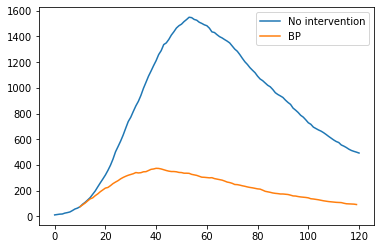

In [15]:
plt.plot(db.index, db.I, label="No intervention")
for k in traces:
    plt.plot(traces[k]["t"]+t1,traces[k]["I"], label=k)
plt.legend()

In [49]:
##### MF SCENARIO #######
import imp
import scenario
imp.reload(scenario)
from scenario import Scenario
import ranking
imp.reload(ranking)
from ranking import RANKINGS
scenario_MF = Scenario(
    model, seed=seed+1, 
    ranking_options=dict(ranking=RANKINGS["backtrack"], 
                         algo="MF", init="all_S", tau=MF_tau, delta=MF_delta,mu=mu,lamb=lamb), 
    observation_options=observation_options,
    intervention_options=intervention_options,
)
scenario_MF.run(t_max-t1, print_every = 1)
print("Save MF strategy", flush=True)
#scenario_MF.counts.to_csv("csv/Proximity_N%dK_T%d_s1_ti%d_pz%d_mu%.2f_l%.2f_seed%d_obs%d_MF_t%d_d%d.csv"%(N/1000,T,t1,N_patient_zero,mu,lamb,seed,n_ranking,MF_tau,MF_delta),
#                  index=False, sep="\t")
scenario_MF.save("csv/Proximity_N%dK_T%d_s1_ti%d_pz%d_mu%.2f_l%.2f_seed%d_obs%d_MF_t%d_d%d_info"%(N/1000,T,t1,N_patient_zero,mu,lamb,seed,n_ranking,MF_tau,MF_delta))
cnts = scenario_MF.counts
cnts["t" ]=cnts.index
traces["MF"] = cnts
save_status(scenario_MF, "MF")

del scenario_MF
# 1h01min per round
print("End seed", flush=True)

Using ranking_backtrack to rank
Using seed=6
Selecting 0/10000 untracked individuals
t = 0 / 110
state: S:9890, I:101, R:9 I+R:110
obser: S:59, I:1, R:0, I+R:1
free birds: 100
obs_symp:0(0), obs_rank:1(1)
pos_rank:1, inf_cont:0.0
t = 1 / 110
state: S:9868, I:121, R:11 I+R:132
obser: S:119, I:1, R:0, I+R:1
free birds: 120
obs_symp:0(0), obs_rank:0(1)
pos_rank:0, inf_cont:0.0
t = 2 / 110
state: S:9846, I:143, R:11 I+R:154
obser: S:177, I:3, R:0, I+R:3
free birds: 140
obs_symp:0(0), obs_rank:2(3)
pos_rank:2, inf_cont:0.0
t = 3 / 110
state: S:9818, I:170, R:12 I+R:182
obser: S:201, I:36, R:3, I+R:39
free birds: 134
obs_symp:0(0), obs_rank:33(36)
pos_rank:33, inf_cont:0.7
t = 4 / 110
state: S:9797, I:184, R:19 I+R:203
obser: S:241, I:55, R:4, I+R:59
free birds: 131
obs_symp:0(0), obs_rank:19(55)
pos_rank:19, inf_cont:4.633333333333334
t = 5 / 110
state: S:9771, I:208, R:21 I+R:229
obser: S:295, I:61, R:4, I+R:65
free birds: 151
obs_symp:0(0), obs_rank:6(61)
pos_rank:6, inf_cont:2.8333333333

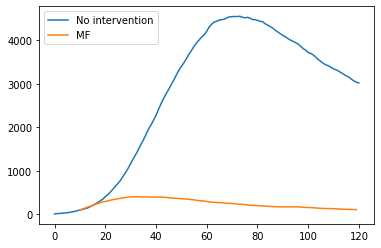

In [50]:
plt.plot(np.array(db.index), db.I.to_numpy(), label="No intervention")
for k in traces:
    plt.plot(traces[k]["t"]+t1,traces[k]["I"], label=k)
plt.legend()

In [51]:
##### CT SCENARIO #######
import imp
import scenario
imp.reload(scenario)
from scenario import Scenario
import ranking
imp.reload(ranking)
from ranking import RANKINGS
scenario_CT = Scenario(
    model, seed=seed+1, 
    ranking_options=dict(ranking=RANKINGS["tracing"], 
                         algo="CT", init="all_S", tau=MF_tau, delta=MF_delta,mu=mu,lamb=lamb), 
    observation_options=observation_options,
    intervention_options=intervention_options,
)
scenario_CT.run(t_max-t1, print_every = 1)
print("Save MF strategy", flush=True)
#scenario_MF.counts.to_csv("csv/Proximity_N%dK_T%d_s1_ti%d_pz%d_mu%.2f_l%.2f_seed%d_obs%d_MF_t%d_d%d.csv"%(N/1000,T,t1,N_patient_zero,mu,lamb,seed,n_ranking,MF_tau,MF_delta),
#                  index=False, sep="\t")
scenario_CT.save("csv/Proximity_N%dK_T%d_s1_ti%d_pz%d_mu%.2f_l%.2f_seed%d_obs%d_CT_t%d_d%d_info"%(N/1000,T,t1,N_patient_zero,mu,lamb,seed,n_ranking,MF_tau,MF_delta))
cnts = scenario_CT.counts
cnts["t" ]=cnts.index
traces["CT"] = cnts
save_status(scenario_CT, "CT")
del scenario_CT
# 1h01min per round
print("End seed", flush=True)

Using ranking_tracing to rank
Using seed=6
Selecting 0/10000 untracked individuals
t = 0 / 110
state: S:9890, I:101, R:9 I+R:110
obser: S:59, I:1, R:0, I+R:1
free birds: 100
obs_symp:0(0), obs_rank:1(1)
pos_rank:1, inf_cont:0.0
t = 1 / 110
state: S:9868, I:121, R:11 I+R:132
obser: S:118, I:2, R:0, I+R:2
free birds: 119
obs_symp:0(0), obs_rank:1(2)
pos_rank:1, inf_cont:0.0
t = 2 / 110
state: S:9847, I:142, R:11 I+R:153
obser: S:177, I:2, R:1, I+R:3
free birds: 140
obs_symp:0(0), obs_rank:0(2)
pos_rank:0, inf_cont:0.0
t = 3 / 110
state: S:9820, I:168, R:12 I+R:180
obser: S:236, I:3, R:1, I+R:4
free birds: 165
obs_symp:0(0), obs_rank:1(3)
pos_rank:1, inf_cont:0.0
t = 4 / 110
state: S:9795, I:186, R:19 I+R:205
obser: S:293, I:6, R:1, I+R:7
free birds: 180
obs_symp:0(0), obs_rank:3(6)
pos_rank:3, inf_cont:0.016666666666666666
t = 5 / 110
state: S:9766, I:213, R:21 I+R:234
obser: S:327, I:30, R:3, I+R:33
free birds: 183
obs_symp:0(0), obs_rank:24(30)
pos_rank:24, inf_cont:1.4166666666666667


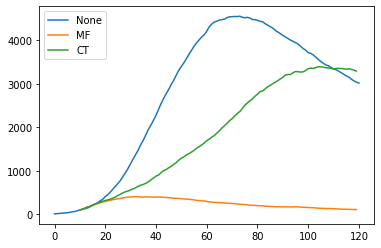

In [52]:
plt.plot(db.index.to_numpy(), db.I.to_numpy(), label="None")
for k in traces:
    plt.plot(traces[k]["t"]+t1,traces[k]["I"], label=k)
plt.legend()

Text(0, 0.5, '$I+R$')

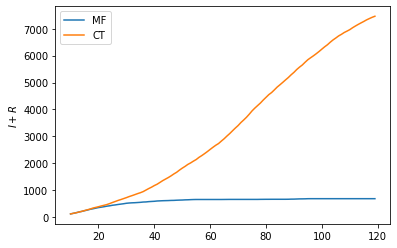

In [53]:
#plt.plot(db.index.to_numpy(), db.I.to_numpy()+db.R.to_numpy(), label="None")
for k in traces:
    plt.plot(traces[k]["t"]+t1,traces[k]["I"]+traces[k]["R"], label=k)
plt.legend()
plt.ylabel("$I+R$")

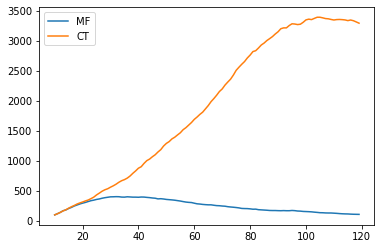

In [54]:
for k in traces:
    plt.plot(traces[k]["t"]+t1,traces[k]["I"], label=k)
plt.legend()

In [55]:
db.index.to_numpy()

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120])

Animation size has reached 21066879 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


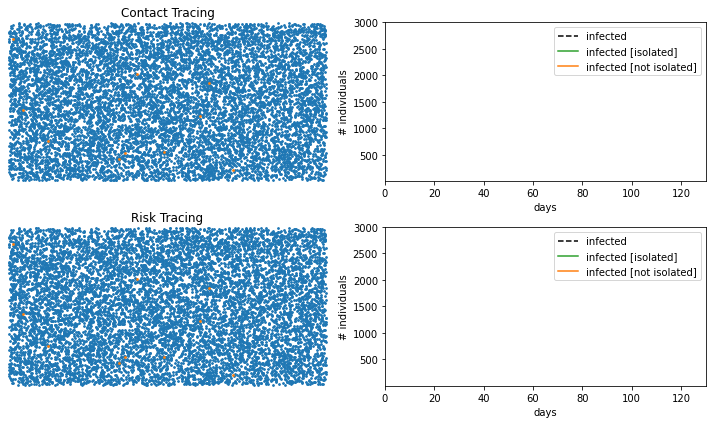

In [80]:
STATES_CONV={"S":0, "I":1, "R":2, "Q":6}

def get_nodes_status(time, status):
    if time < t1:
        return {k:np.where(all_states[time]==i)[0] 
                  for k, i in STATES_CONV.items()}

    x = status[status.t==time]
    out={}
    quar = (x.q==1)
    out["Q"] = (x[quar].i).values
    out["S"] = (x[(x.s==0)].i).values
    nq = np.logical_not(quar)
    out["I"] = (x[(x.s==1) & nq].i).values
    out["R"] = (x[(x.s==2)].i).values
    return out
def setup_start(axs, pos_nodes, nodes_keys, colors, fn_get_nodes, ALGOS, fract = 4, s=3):
    paths = {}
    for i_ax, ALGO in enumerate(ALGOS):
        nodes_idx = fn_get_nodes(0, ranks_status[ALGO].convert_dtypes())
        paths[ALGO] = {"points":{}, "traces":{"I":{}, "q":{},"fb":{}}}
        for nk, color in zip(nodes_keys, colors):
            g=pos_nodes.iloc[nodes_idx[nk]]
            paths[ALGO]["points"][nk] = axs[i_ax][0].scatter(g["x"]/fract,g["y"]/fract,color=color, s=s)
        paths[ALGO]["traces"]["I"], = axs[i_ax][1].plot(traces[ALGO]["t"][:time],traces[ALGO]["I"][:time]+ traces[ALGO]["R"][:time], label="infected", color="black", ls="--")
        paths[ALGO]["traces"]["q"], = axs[i_ax][1].plot(traces[ALGO]["t"][:time],traces[ALGO]["q"][:time], label="infected [isolated]", color=colors[2])
        paths[ALGO]["traces"]["fb"], = axs[i_ax][1].plot(traces[ALGO]["t"][:time],traces[ALGO]["free_birds"][:time], label="infected [not isolated]", color=colors[1])
        #axs[i_ax][1].set_yscale('log')
        axs[i_ax][1].legend()
    #axs[0][1].set_title("Contact Tracing")
    #axs[1][1].set_title("Epidemic Tracing")
    axs[0][0].set_title("Contact Tracing")
    axs[1][0].set_title("Risk Tracing")
    axs[0][1].set_xlabel("days")
    axs[1][1].set_xlabel("days")
    axs[0][1].set_ylabel("# individuals")
    axs[1][1].set_ylabel("# individuals")
    plt.tight_layout()
    return paths

from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML, display
import seaborn as sns

fract = 1
ALGOS=["CT","MF"]
fig , axs = plt.subplots(2,2,figsize=(10,6), frameon=False)
lim=0.6
ax1=axs[0][0]
ax1.set(xlim=(pos_nodes.x.max()/fract+lim, pos_nodes.x.min()/fract-lim),
      ylim=(pos_nodes.y.max()/fract+lim, pos_nodes.y.min()/fract-lim))
ax2=axs[1][0]
ax2.set(xlim=(pos_nodes.x.max()/fract+lim, pos_nodes.x.min()/fract-lim),
      ylim=(pos_nodes.y.max()/fract+lim, pos_nodes.y.min()/fract-lim))
for i in range(2):
    axs[i][1].set(xlim=(0, T+10),
      ylim=(1,3000))

#fig.patch.set_visible(False)
ax1.axis('off')
ax1.set_xticks([])
ax1.set_yticks([])
ax2.axis('off')
ax2.set_xticks([])
ax2.set_yticks([])

plt.tight_layout()
time = 0
#statuss = []
#for ALGO in ALGOS:
#    statuss.append(ranks_status[ALGO].convert_dtypes())

st_val= ["S","I","Q"]
color = sns.color_palette("tab10",n_colors = len(st_val))

paths = setup_start(axs, pos_nodes, st_val, colors=color,
                   fn_get_nodes=get_nodes_status,ALGOS=ALGOS, fract=fract)

def animate(time):
    if time >= T:
        time = T-1
    for i_ax, ALGO in enumerate(ALGOS):
        nodes_idx = get_nodes_status(time, ranks_status[ALGO].convert_dtypes())
        for k in st_val:
            g=pos_nodes.iloc[nodes_idx[k]]
            paths[ALGO]["points"][k].set_offsets(np.c_[g["x"].values/fract, g["y"].values/fract])
        paths[ALGO]["traces"]["I"].set_data(traces[ALGO]["t"][:time],traces[ALGO]["I"][:time] + traces[ALGO]["R"][:time])
        paths[ALGO]["traces"]["q"].set_data(traces[ALGO]["t"][:time],traces[ALGO]["q"][:time])
        paths[ALGO]["traces"]["fb"].set_data(traces[ALGO]["t"][:time],traces[ALGO]["free_birds"][:time])
    
    #plt.draw()

anim = FuncAnimation(
    fig, animate, interval=100, frames=int(T)+30, cache_frame_data=False)

#plt.draw()
#plt.show()
display(HTML(anim.to_jshtml()))
#anim.save("sim.mov", codec="h263p", bitrate=-1)
#anim.save(f"sim_{ALGO}.webm", codec="libvpx-vp9")
writer=PillowWriter(fps=15)
anim.save(f"animate.gif",writer=writer)